In [1]:
import ast
import os
import shutil

import albumentations
import cv2
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import pydicom as dicom
import tensorflow as tf
from IPython.core.interactiveshell import InteractiveShell
from PIL import Image
from tensorflow import keras
from tqdm import tqdm
from src.augment import Aug, Aug_No_transform, Flip_Aug, Hard_Aug, Transform_Aug
InteractiveShell.ast_node_interactivity = "all"
from src.generator import Generator

In [2]:
base_config = {
    "IMG_HEIGH": 600,
    "IMG_WIDTH": 600,
    "BATCH_SIZE": 16,
    "SEED": 42,
}
classes = {"negative": 0, "typical": 1, "indeterminate": 2, "atypical": 3}

In [3]:
df = pd.read_csv("/app/_data/predicted_crop_v1.csv")

In [4]:
list_wrong = df[(df["class"] != "negative") & (df["label"] == "none 1 0 0 1 1")][
    "id_image"
].tolist()
df = df.query("id_image not in @list_wrong").reset_index(drop=True)

In [5]:
df["class_id"] = df["class"].replace(classes)

In [6]:
df["image"] = df["image"].str.replace(".dcm", "")

<ipython-input-6-1cc0c88b09b6>:1: FutureWarning: The default value of regex will change from True to False in a future version.
  df["image"] = df["image"].str.replace(".dcm", "")


# crop and bboxes

In [13]:
df.columns

Index(['id_image', 'boxes', 'label', 'StudyInstanceUID', 'image', 'id_study',
       'Negative for Pneumonia', 'Typical Appearance',
       'Indeterminate Appearance', 'Atypical Appearance', 'class', 'path',
       'modality', 'PatientSex', 'BodyPartExamined',
       'PhotometricInterpretation', 'Rows', 'Columns', 'width', 'height',
       'n_bbox', 'modality_id', 'p_sex', 'body_part_id', 'xmin', 'ymin',
       'xmax', 'ymax', 'crop_w', 'crop_h', 'class_id'],
      dtype='object')

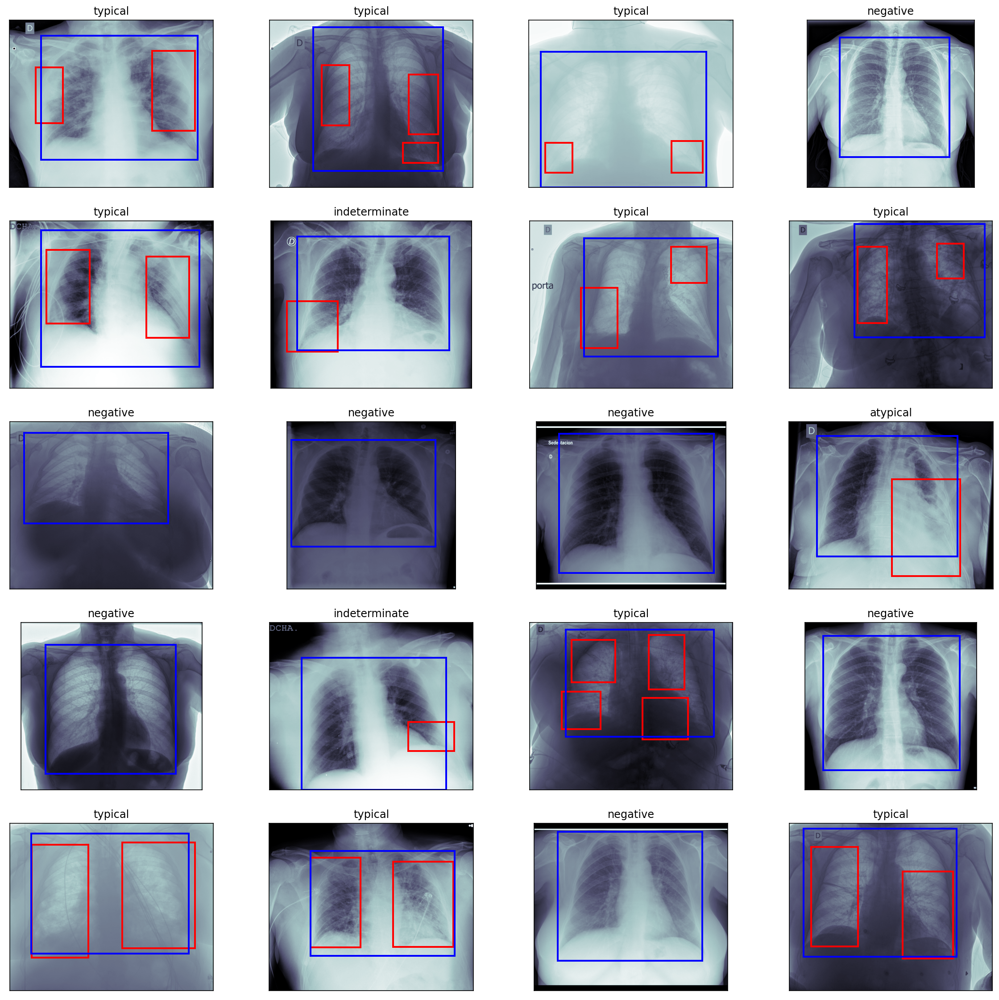

In [15]:
plt.figure(figsize=(20, 20))
sample_df = df.sample(20).reset_index(drop=True)
for i in range(20):
    img = dicom.dcmread(sample_df.loc[i]["path"])
    img = img.pixel_array
    label = sample_df.loc[i, "class"]
    ax = plt.subplot(5, 4, i + 1)
    if type(sample_df.loc[i, "boxes"]) != float:
        boxes = ast.literal_eval(sample_df.loc[i, "boxes"])
        for box in boxes:
            rect = plt.Rectangle(
                (box["x"], box["y"]),
                box["width"],
                box["height"],
                ec="r",
                fc="none",
                lw=2.0,
            )
            ax.add_patch(rect)
    rect = plt.Rectangle(
                (sample_df.loc[i, "xmin"]*sample_df.loc[i, "width"], sample_df.loc[i, "ymin"]*sample_df.loc[i, "height"]),
                (sample_df.loc[i, "xmax"] - sample_df.loc[i, "xmin"])*sample_df.loc[i, "width"],
                (sample_df.loc[i, "ymax"] - sample_df.loc[i, "ymin"])*sample_df.loc[i, "height"],
                ec="b",
                fc="none",
                lw=2.0,
            )
    ax.add_patch(rect)
    plt.title(label)
    ax.imshow(img, cmap=plt.cm.bone)
    plt.xticks([])
    plt.yticks([])
plt.show();

## testing different methods of albumentations

In [ ]:
img = Image.open("/app/_data/jpg/" + os.listdir("/app/_data/jpg/")[88])
img = img.resize((600, 600))
img = np.array(img)


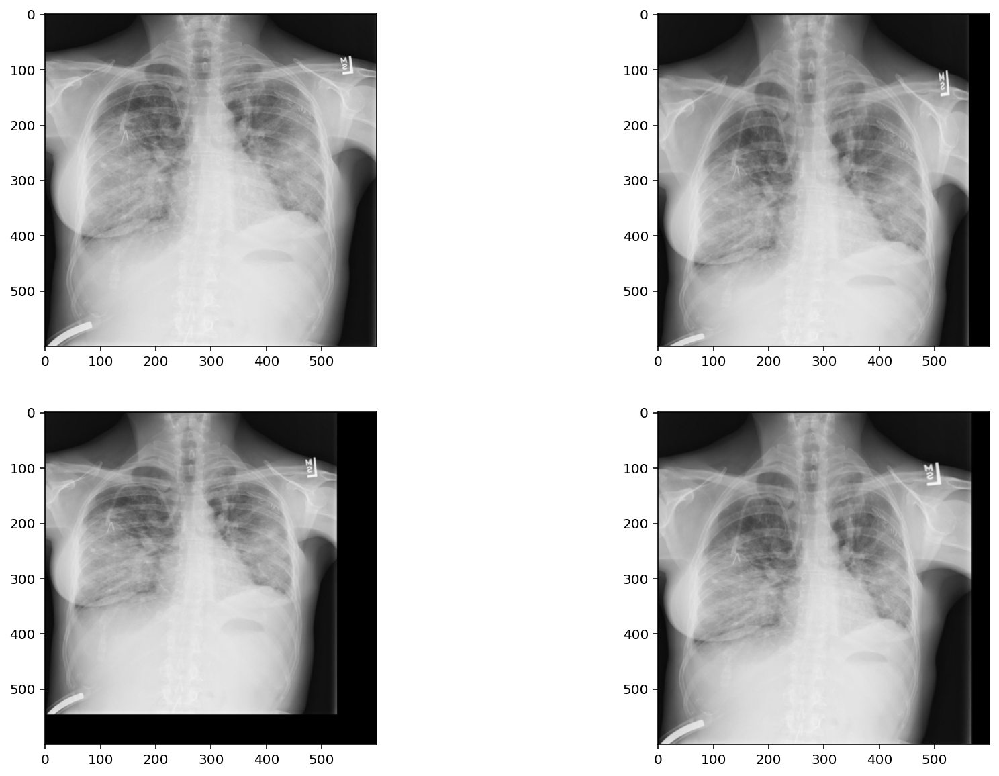

In [7]:
t = albumentations.Compose(
    [
        albumentations.GridDistortion(
            num_steps=5,
            distort_limit=0.3,
            interpolation=cv2.INTER_LINEAR,
            border_mode=0,
            p=1,
        ),
    ]
)
plt.figure(figsize=(15, 10))

plt.subplot(2, 2, 1)
plt.imshow(img)
plt.subplot(2, 2, 2)
plt.imshow(t(image=img)["image"])
plt.subplot(2, 2, 3)
plt.imshow(t(image=img)["image"])
plt.subplot(2, 2, 4)
plt.imshow(t(image=img)["image"])
plt.show();

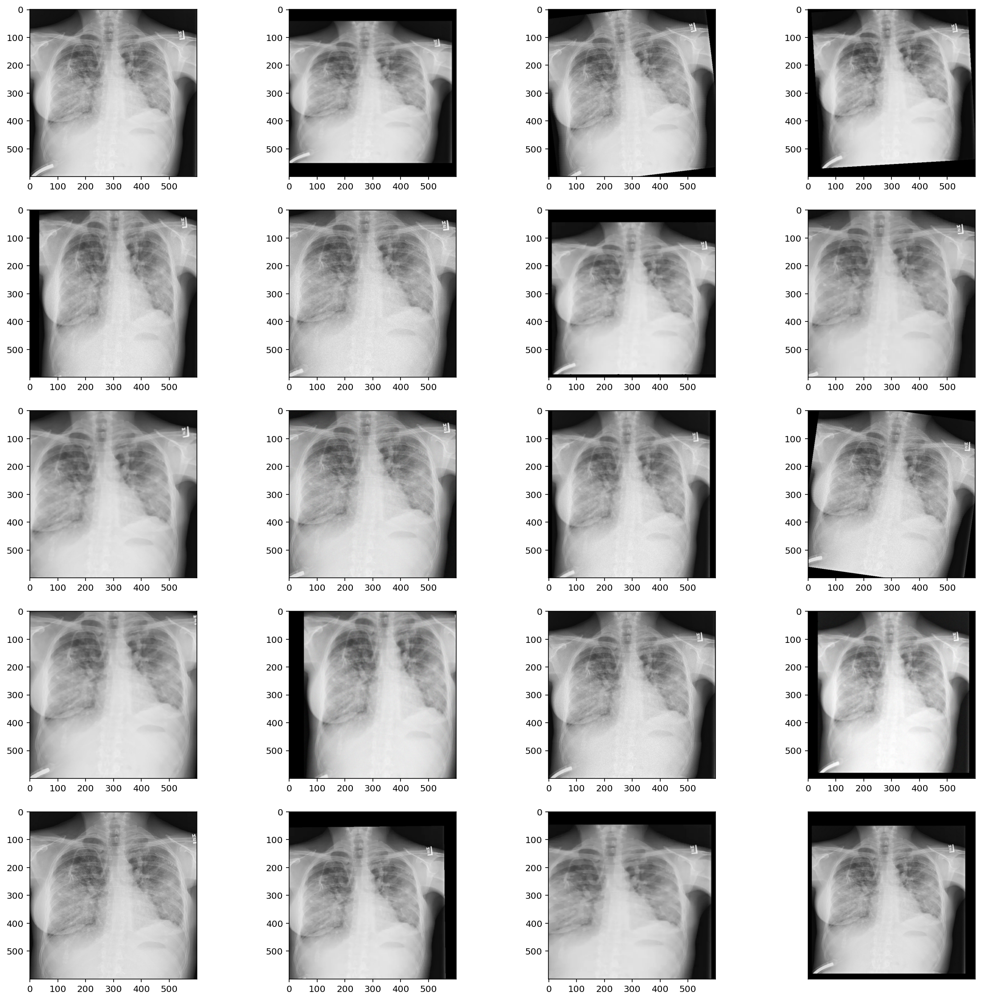

In [8]:
plt.figure(figsize=(20, 20))
plt.subplot(5, 4, 1)
plt.imshow(img)
for i in range(19):
    x = Aug.augment_image(img)
    plt.subplot(5, 4, i + 2)
    plt.imshow(x)
plt.xticks([])
plt.yticks([])
plt.show();

In [4]:
gen = Generator(
    df=df,
    batch_size=20,
    seed=42,
    img_size=600,
    cache_img_path="/app/_data/crop_npy_600/",
    shuffle=False,
    label_columns=[
        "Negative for Pneumonia",
        "Typical Appearance",
        "Indeterminate Appearance",
        "Atypical Appearance",
    ],
    augment_fn=None,
    crop=True,
)

In [5]:
a, b = gen.__getitem__(8)

In [35]:
class Aug:
    def augment_image(img):
        h = img.shape[0]
        w = img.shape[1]
        transform = albumentations.Compose(
            [
                albumentations.OneOf(
                    [
                        albumentations.MotionBlur((3, 5)),
                        albumentations.MedianBlur(blur_limit=5),
                        albumentations.GaussianBlur(blur_limit=(3, 5), sigma_limit=0),
                        albumentations.Blur(blur_limit=(3, 5)),
                    ],
                    p=0.1,
                ),
                albumentations.OneOf(
                    [
                        albumentations.GaussNoise(var_limit=[10, 20], mean=1),
                        albumentations.ImageCompression(
                            quality_lower=85, quality_upper=100, compression_type=1
                        ),
                        albumentations.MultiplicativeNoise(
                            multiplier=(0.95, 1.05), per_channel=False, elementwise=True
                        ),
                        albumentations.Downscale(
                            scale_min=0.85,
                            scale_max=0.99,
                            interpolation=cv2.INTER_LINEAR,
                        ),
                    ],
                    p=0.1,
                ),
                albumentations.OneOf(
                    [
                        albumentations.RandomBrightnessContrast(
                            brightness_limit=(-0.1, 0.2),
                            contrast_limit=(-0.1, 0.2),
                            brightness_by_max=True,
                        ),
                        albumentations.augmentations.transforms.Sharpen(
                            alpha=(0.05, 0.1), lightness=(0.5, 1.0)
                        ),
                        albumentations.augmentations.transforms.RandomToneCurve(
                            scale=0.05
                        ),
                    ],
                    p=0.1,
                ),
                albumentations.OneOf(
                    [
                        albumentations.OpticalDistortion(
                            distort_limit=0.1,
                            shift_limit=0.1,
                            border_mode=1,
                        ),
                        albumentations.ElasticTransform(
                            alpha=2.0,
                            sigma=2.0,
                            alpha_affine=2.0,
                            interpolation=cv2.INTER_LINEAR,
                            border_mode=1,
                        ),
                        albumentations.GridDistortion(
                            num_steps=5,
                            distort_limit=0.1,
                            interpolation=cv2.INTER_LINEAR,
                            border_mode=1,
                        ),
                    ],
                    p=0.1,
                ),
                albumentations.OneOf(
                    [
                        albumentations.augmentations.crops.transforms.CropAndPad(
                            px=None,
                            percent=(-0.01, 0.05),
                            pad_mode=1,
                            pad_cval=0,
                            pad_cval_mask=0,
                            keep_size=True,
                            sample_independently=True,
                            interpolation=cv2.INTER_LINEAR,
                        ),
                        albumentations.RandomSizedCrop(
                            min_max_height=(0.95 * h, 0.95 * w),
                            height=h,
                            width=w,
                            w2h_ratio=1.0,
                            interpolation=cv2.INTER_LINEAR,
                        ),
                        albumentations.HorizontalFlip(),
                        albumentations.VerticalFlip(),
                        albumentations.RandomRotate90(),
                    ],
                    p=0.1,
                ),
                albumentations.CoarseDropout(
                    max_holes=10,
                    max_height=36,
                    max_width=36,
                    min_holes=1,
                    min_height=6,
                    min_width=6,
                    fill_value=0,
                    p=0.1
                ),
            ]
        )

        return transform(image=img)["image"]

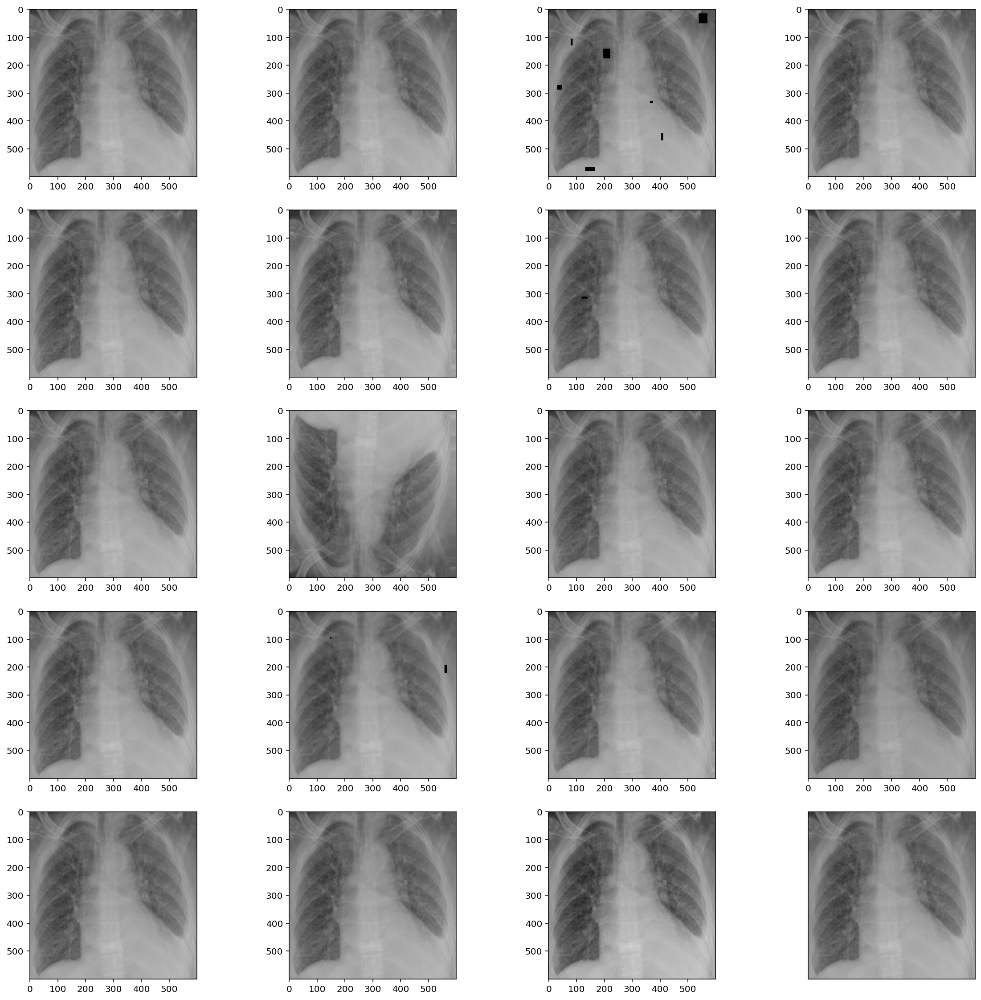

In [37]:
img = a[11]
plt.figure(figsize=(20, 20))
plt.subplot(5, 4, 1)
plt.imshow(img)
for i in range(19):
    x = Aug.augment_image(img)
    plt.subplot(5, 4, i + 2)
    plt.imshow(x)
plt.xticks([])
plt.yticks([])
plt.show();

# voi_lut=True vs voi_lut=False

In [10]:
for i in tqdm(range(100)):
    ix = np.random.randint(0, len(df))
    img_path = df.loc[ix, "path"]
    img_type = df.loc[ix, "PhotometricInterpretation"]
    data_file = dicom.dcmread(img_path)
    img_voi = dicom.pixel_data_handlers.util.apply_voi_lut(
        data_file.pixel_array, data_file
    )
    img = data_file.pixel_array
    if img_type == "MONOCHROME1":
        img = img.max() - img
        img_voi = img_voi.max() - img_voi
    img = (img - img.min()) / (img.max() - img.min())
    img = (np.array(img) * 255).astype("uint8")
    img = np.stack([img, img, img], axis=-1)
    img_voi = (img_voi - img_voi.min()) / (img_voi.max() - img_voi.min())
    img_voi = (np.array(img_voi) * 255).astype("uint8")
    img_voi = np.stack([img_voi, img_voi, img_voi], axis=-1)
    if np.sum(img != img_voi) > 0:
        print(np.sum(img != img_voi))

100%|██████████| 100/100 [00:32<00:00,  3.10it/s]


Image with voi_lut== image without

# original images

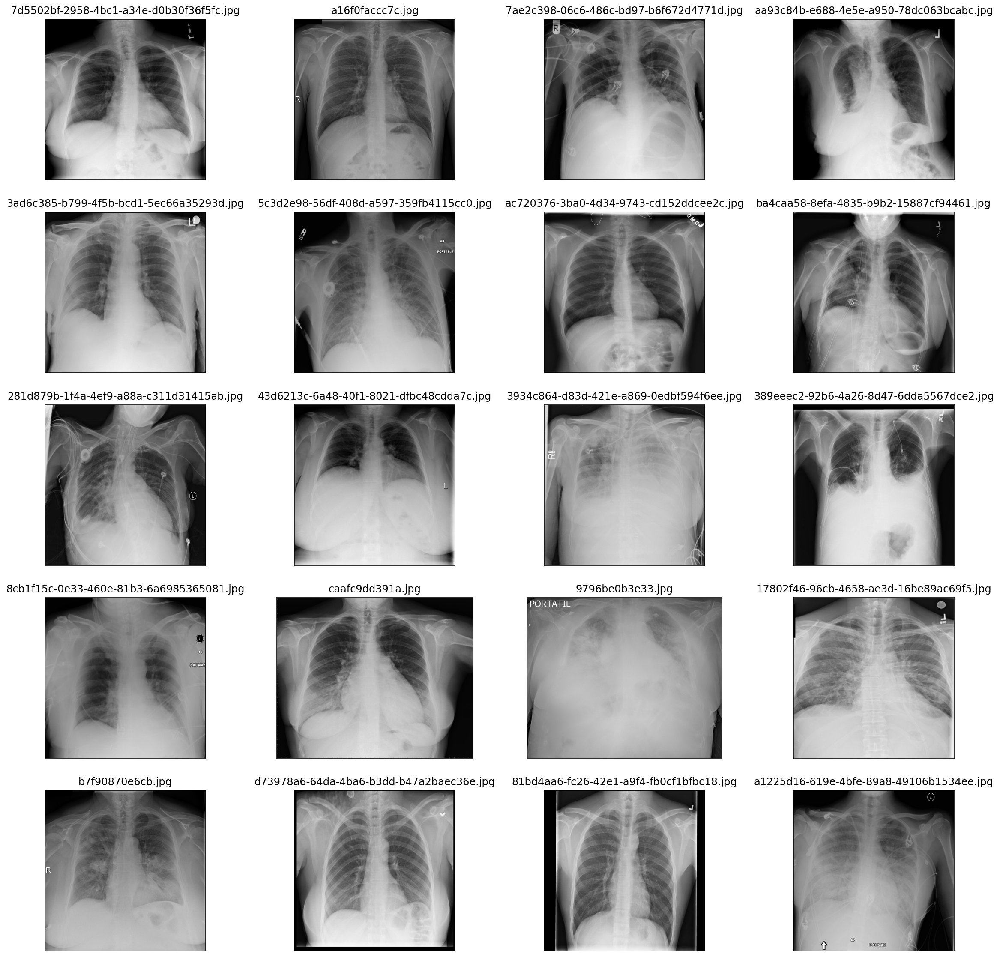

In [10]:
plt.figure(figsize=(20, 20))
l = []
for i in range(20):
    ix = np.random.randint(0, len(os.listdir("/app/_data/jpg/")))
    l.append(os.listdir("/app/_data/jpg/")[ix])
    j = Image.open("/app/_data/jpg/" + os.listdir("/app/_data/jpg/")[ix])
    plt.subplot(5, 4, i + 1)
    plt.title(os.listdir("/app/_data/jpg/")[ix])
    plt.imshow(j)
    plt.xticks([])
    plt.yticks([])
plt.show();

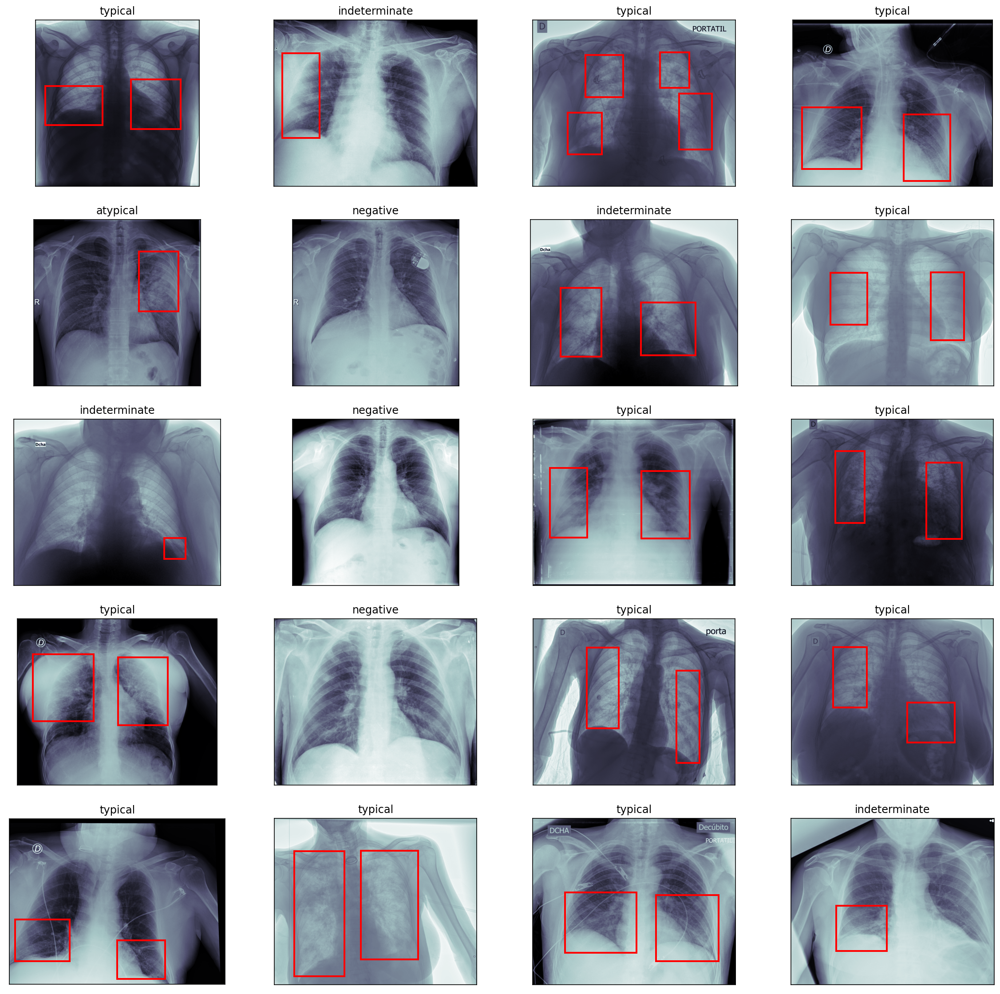

In [13]:
plt.figure(figsize=(20, 20))
sample_df = df.sample(20).reset_index(drop=True)
for i in range(20):
    img = dicom.dcmread(sample_df.loc[i]["path"])
    img = img.pixel_array
    label = sample_df.loc[i, "class"]
    ax = plt.subplot(5, 4, i + 1)
    if type(sample_df.loc[i, "boxes"]) != float:
        boxes = ast.literal_eval(sample_df.loc[i, "boxes"])
        for box in boxes:
            rect = plt.Rectangle(
                (box["x"], box["y"]),
                box["width"],
                box["height"],
                ec="r",
                fc="none",
                lw=2.0,
            )
            ax.add_patch(rect)
    plt.title(label)
    ax.imshow(img, cmap=plt.cm.bone)
    plt.xticks([])
    plt.yticks([])
plt.show();

# Make new imgs

In [11]:
def make_bbox_dataset(df, path="/app/_data/jpg/"):
    data = pd.DataFrame(
        columns=[
            "study",
            "img",
            "label",
            "bbox",
            "x_center",
            "y_center",
            "width",
            "height",
            "class",
        ]
    )
    labels_path = os.path.join(path, "labels_alb_format")
    os.makedirs(labels_path)
    for ix in df.index.tolist():
        img_name = df.loc[ix, "image"]
        study = df.loc[ix, "StudyInstanceUID"]
        img_w = df.loc[ix, "width"]
        img_h = df.loc[ix, "height"]
        label = df.loc[ix, "class"]
        if df.loc[ix, "boxes"] == df.loc[ix, "boxes"]:
            boxes = ast.literal_eval(df.loc[ix, "boxes"])
            list_boxes_alb = np.zeros([len(boxes), 5])
            list_boxes_yolo = np.zeros([len(boxes), 5])
            for i, box in enumerate(boxes):
                x_center = (box["x"] + box["width"] / 2) / img_w
                y_center = (box["y"] + box["height"] / 2) / img_h
                width = box["width"] / img_w
                height = box["height"] / img_h
                data = data.append(
                    {
                        "study": study,
                        "img": img_name,
                        "label": label,
                        "bbox": 1,
                        "x_center": x_center,
                        "y_center": y_center,
                        "width": width,
                        "height": height,
                        "class": 0,
                    },
                    ignore_index=True,
                )
                list_boxes_alb[i] = np.array([x_center, y_center, width, height, 0])
                list_boxes_yolo[i] = np.array([0, x_center, y_center, width, height])
            np.save(labels_path + "/" + img_name + ".npy", list_boxes_alb)
        else:
            data = data.append(
                {
                    "study": study,
                    "img": img_name,
                    "label": label,
                    "bbox": 0,
                    "x_center": np.nan,
                    "y_center": np.nan,
                    "width": np.nan,
                    "height": np.nan,
                    "class": 0,
                },
                ignore_index=True,
            )
    return data

In [12]:
shutil.rmtree("/app/_data/jpg/labels_alb_format/")

In [13]:
bbox_df = make_bbox_dataset(df)

In [14]:
bbox_df

,study,img,label,bbox,x_center,y_center,width,height,class
0,5776db0cec75,000a312787f2,typical,1,0.306066,0.441824,0.241226,0.549685,0
1,5776db0cec75,000a312787f2,typical,1,0.656307,0.422013,0.257204,0.505031,0
2,ff0879eb20ed,000c3a3f293f,negative,0,NaN,NaN,NaN,NaN,0
3,9d514ce429a7,0012ff7358bc,typical,1,0.363652,0.274319,0.283965,0.392996,0
4,9d514ce429a7,0012ff7358bc,typical,1,0.687567,0.394942,0.201907,0.473411,0
...,...,...,...,...,...,...,...,...,...
9584,7eed9af03814,ffd9b6cf2961,typical,1,0.296171,0.480181,0.128571,0.355606,0
9585,a0cb0b96fb3d,ffdc682f7680,typical,1,0.817057,0.468622,0.351563,0.746727,0
9586,a0cb0b96fb3d,ffdc682f7680,typical,1,0.314128,0.565537,0.155599,0.222429,0
9587,7d82d53204b8,ffe942c8655f,typical,1,0.313157,0.355756,0.325139,0.550925,0


In [15]:
bbox_df.to_csv("/app/_data/bboxes.csv", index=False)

In [16]:
os.listdir("/app/_data/jpg/labels_alb_format/")[33]

'8705f5ccccf8.npy'

In [17]:
img = Image.open("/app/_data/jpg/8705f5ccccf8.jpg")
img = np.array(img)
bbox = np.load("/app/_data/jpg/labels_alb_format/8705f5ccccf8.npy")

In [18]:
# transformed = Aug_bbox.augment_image(img, bbox)
# transformed_image = transformed["image"]
# transformed_bboxes = transformed["bboxes"]

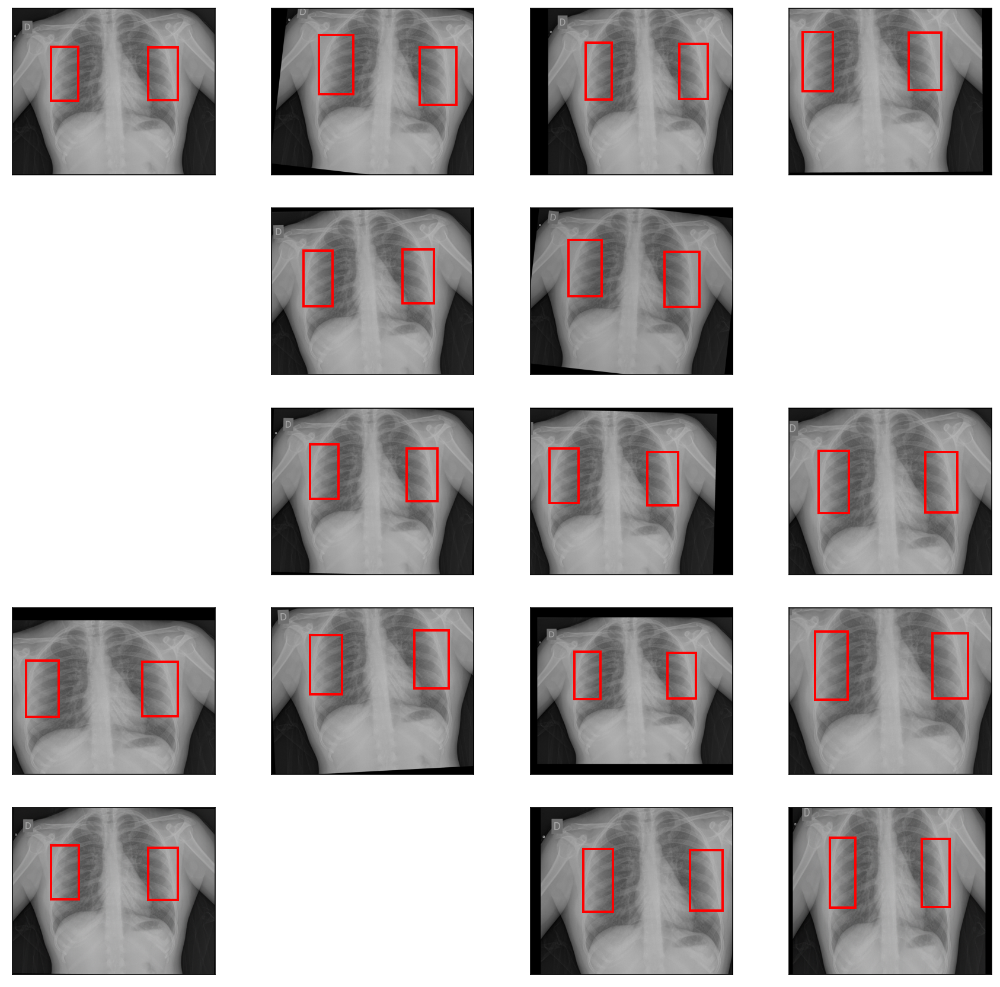

In [19]:
plt.figure(figsize=(15, 15))
ax1 = plt.subplot(5, 4, 1)
ww = img.shape[1]
hh = img.shape[0]
for box in bbox:
    rect = plt.Rectangle(
        ((box[0] - box[2] / 2) * ww, (box[1] - box[3] / 2) * hh),
        box[2] * ww,
        box[3] * hh,
        ec="r",
        fc="none",
        lw=2.0,
    )
    ax1.add_patch(rect)
ax1.imshow(img)
plt.xticks([])
plt.yticks([])
for i in range(19):
    try:
        transformed = Aug_bbox.augment_image(img, bbox)
        transformed_image = transformed["image"]
        transformed_bboxes = transformed["bboxes"]
        ww = transformed_image.shape[1]
        hh = transformed_image.shape[0]
        ax2 = plt.subplot(5, 4, i + 2)
        for box in transformed_bboxes:
            rect = plt.Rectangle(
                ((box[0] - box[2] / 2) * ww, (box[1] - box[3] / 2) * hh),
                box[2] * ww,
                box[3] * hh,
                ec="r",
                fc="none",
                lw=2.0,
            )
            ax2.add_patch(rect)

        ax2.imshow(transformed_image)
        plt.xticks([])
        plt.yticks([])
    except:
        continue

plt.show();

## make transformed images for yolo

In [20]:
def make_transformed_imgs(df, folder):
    if not os.path.exists(folder):
        os.makedirs(folder)
    else:
        shutil.rmtree(folder)
        os.makedirs(folder)
    data = df.copy()
    for img_name in tqdm(data["img"].unique().tolist()):
        new_df = data[data["img"] == img_name].reset_index(drop=True)
        label = new_df.loc[0, "label"]
        img = Image.open("/app/_data/jpg/" + img_name + ".jpg")
        shutil.copy("/app/_data/jpg/" + img_name + ".jpg", folder + img_name + ".jpg")
        img = np.array(img)
        study = new_df.loc[0, "study"]
        if new_df.loc[0, "bbox"] == 1:
            old_bbox = new_df[
                ["x_center", "y_center", "width", "height", "class"]
            ].values
            for i in range(3):
                new_name = img_name + "_tr_" + str(i)
                try:
                    transformed = Aug_bbox.augment_image(img, old_bbox)
                    transformed_image = transformed["image"]
                    transformed_image = Image.fromarray(transformed_image)
                    transformed_image.save(folder + new_name + ".jpg")
                    transformed_bboxes = transformed["bboxes"]
                    for box in transformed_bboxes:
                        data = data.append(
                            {
                                "study": study,
                                "img": new_name,
                                "label": label,
                                "bbox": 1,
                                "x_center": box[0],
                                "y_center": box[1],
                                "width": box[2],
                                "height": box[3],
                                "class": 0,
                            },
                            ignore_index=True,
                        )
                except:
                    i = i - 1
        else:
            for i in range(2):
                new_name = img_name + "_tr_" + str(i)
                try:
                    new_img = Aug.augment_image(img)
                    new_img = Image.fromarray(new_img)
                    new_img.save(folder + new_name + ".jpg")
                    data = data.append(
                        {
                            "study": study,
                            "img": new_name,
                            "label": label,
                            "bbox": 0,
                            "x_center": np.nan,
                            "y_center": np.nan,
                            "width": np.nan,
                            "height": np.nan,
                            "class": 0,
                        },
                        ignore_index=True,
                    )
                except:
                    i = i - 1
    return data

In [21]:
new_df = make_transformed_imgs(bbox_df, "/app/_data/jpg_transformed/")

100%|██████████| 6030/6030 [1:52:24<00:00,  1.12s/it]  


In [22]:
new_df

,study,img,label,bbox,x_center,y_center,width,height,class
0,5776db0cec75,000a312787f2,typical,1,0.306066,0.441824,0.241226,0.549685,0
1,5776db0cec75,000a312787f2,typical,1,0.656307,0.422013,0.257204,0.505031,0
2,ff0879eb20ed,000c3a3f293f,negative,0,NaN,NaN,NaN,NaN,0
3,9d514ce429a7,0012ff7358bc,typical,1,0.363652,0.274319,0.283965,0.392996,0
4,9d514ce429a7,0012ff7358bc,typical,1,0.687567,0.394942,0.201907,0.473411,0
...,...,...,...,...,...,...,...,...,...
28096,7d82d53204b8,ffe942c8655f_tr_0,typical,1,0.621485,0.321930,0.304686,0.459157,0
28097,7d82d53204b8,ffe942c8655f_tr_1,typical,1,0.369142,0.430702,0.314027,0.555261,0
28098,7d82d53204b8,ffe942c8655f_tr_1,typical,1,0.743331,0.442105,0.297976,0.483643,0
28099,7d82d53204b8,ffe942c8655f_tr_2,typical,1,0.317952,0.357895,0.282309,0.565257,0


In [23]:
new_df.to_csv("/app/_data/transformed_bboxes_df.csv", index=False)

70a7e221ebf5_tr_2.jpg
81965b5cb107.jpg
a5d628756358_tr_1.jpg
2db35831f400.jpg
289aa511da37_tr_2.jpg
838c06d70303_tr_1.jpg
50fcd52cecf5.jpg
4c45ed919f45.jpg
66beec6db90c_tr_2.jpg
99cca0762a16.jpg


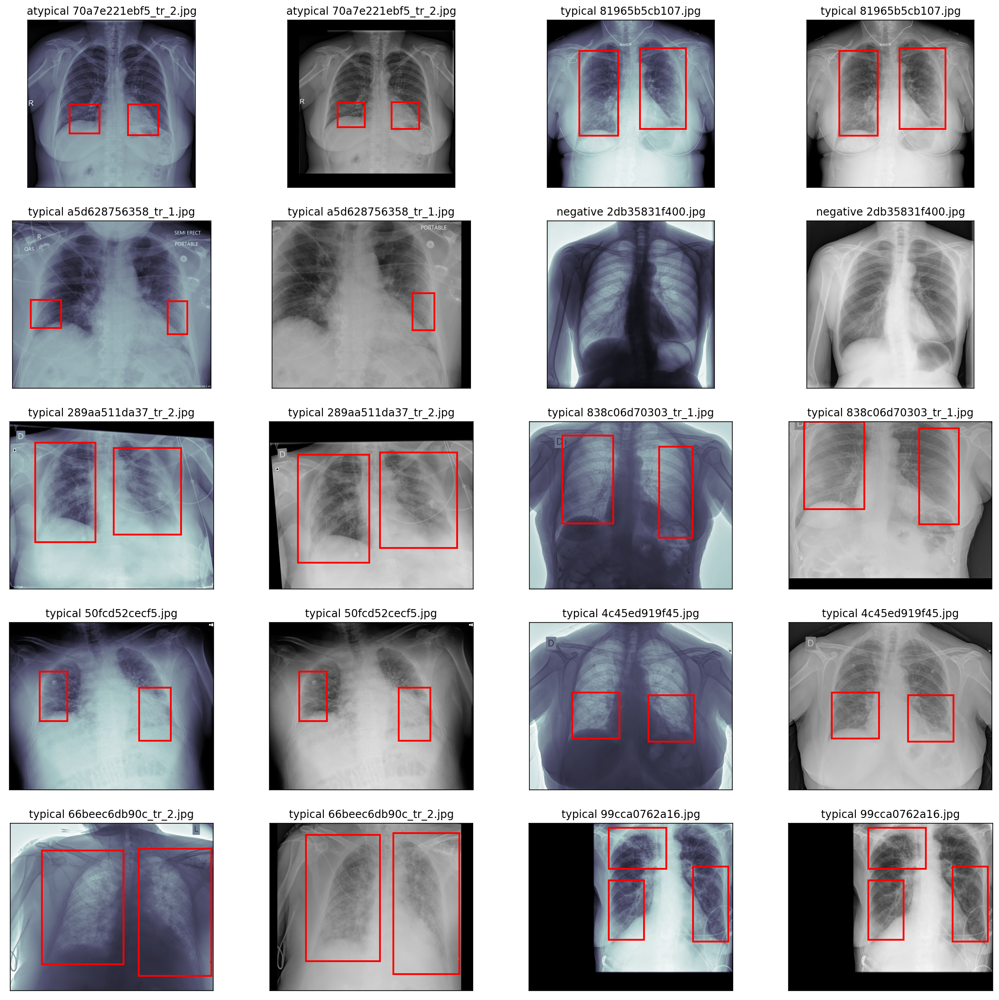

In [24]:
plt.figure(figsize=(20, 20))
for i in range(1, 21, 2):
    img_name = os.listdir("/app/_data/jpg_transformed/")[i]
    print(img_name)
    sample_df = df[df["image"] == img_name[:-4].split("_")[0]].reset_index(drop=True)
    img = dicom.dcmread(sample_df.loc[0, "path"])
    img = img.pixel_array
    label = sample_df.loc[0, "class"]
    ax = plt.subplot(5, 4, i)
    if type(sample_df.loc[0, "boxes"]) != float:
        boxes = ast.literal_eval(sample_df.loc[0, "boxes"])
        for box in boxes:
            rect = plt.Rectangle(
                (box["x"], box["y"]),
                box["width"],
                box["height"],
                ec="r",
                fc="none",
                lw=2.0,
            )
            ax.add_patch(rect)
    plt.title(label + " " + img_name)
    ax.imshow(img, cmap=plt.cm.bone)
    plt.xticks([])
    plt.yticks([])

    img2 = Image.open("/app/_data/jpg_transformed/" + img_name)
    ww = img2.size[0]
    hh = img2.size[1]
    bbox = new_df[new_df["img"] == img_name[:-4]][
        ["x_center", "y_center", "width", "height"]
    ].values
    ax2 = plt.subplot(5, 4, i + 1)
    for box in bbox:
        rect = plt.Rectangle(
            ((box[0] - box[2] / 2) * ww, (box[1] - box[3] / 2) * hh),
            box[2] * ww,
            box[3] * hh,
            ec="r",
            fc="none",
            lw=2.0,
        )
        ax2.add_patch(rect)
    plt.title(label + " " + img_name)
    ax2.imshow(img2, cmap=plt.cm.bone)
    plt.xticks([])
    plt.yticks([])


plt.show();

# check '/app/_data/jpg/' images

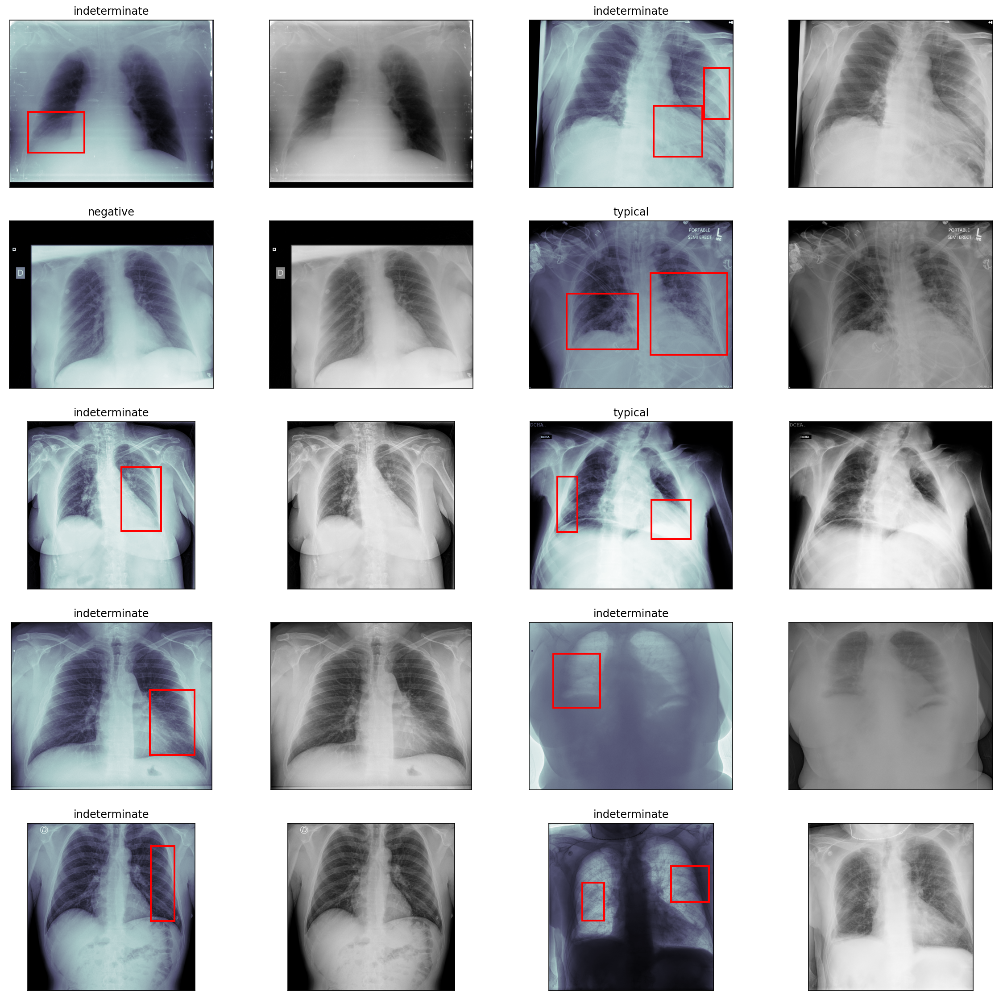

In [68]:
plt.figure(figsize=(20, 20))
for i in range(1, 21, 2):
    d = df.sample(1)
    img_name = d["id_image"].values[0][:-6]
    img = dicom.dcmread(d["path"].values[0])
    img = img.pixel_array
    label = d["class"].values[0]
    ax = plt.subplot(5, 4, i)
    if type(d["boxes"].values[0]) != float:
        boxes = ast.literal_eval(d["boxes"].values[0])
        for box in boxes:
            rect = plt.Rectangle(
                (box["x"], box["y"]),
                box["width"],
                box["height"],
                ec="r",
                fc="none",
                lw=2.0,
            )
            ax.add_patch(rect)
    plt.title(label)
    ax.imshow(img, cmap=plt.cm.bone)
    plt.xticks([])
    plt.yticks([])

    img = Image.open("/app/_data/jpg/" + img_name + ".jpg")
    ax2 = plt.subplot(5, 4, i + 1)
    ax2.imshow(img, cmap=plt.cm.bone)
    plt.xticks([])
    plt.yticks([])


plt.show();